

# Global Trends in Mental Health Disorder Data Analysis

This is my first project (YAY!) working with data science, which analyzes global trends in mental health disorders. The aim of this project is understand the trends and provide a more insightful overview of the patterns with mental health disorders, and to answer some basic questions.

I have used various libraries like Pandas, Numpy, and data visualization libraries such as Matplotlib, Seaborn, and Geopandas library for plotting North American Maps.

<center><img alt="Insight logo" src="https://buzzrx.s3.amazonaws.com/0b5931ef-9e95-4431-a5e3-d2b59935e687/MentalIllness.png" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>


This is a global dataset of mental health disorders such as schizophrenia, bipolar disorder, eating disorders, anxiety disorders, drug use disorders, depression, and alcohol use disorders. 
    
It organizes data of mental health disorders per year, gender, and country. 
 
Datasets Used :

- https://www.kaggle.com/datasets/thedevastator/gender-mental-disorder-prevalence-2019



Questions: 

- What are the top 10 countries with the highest percentage of Depressive Disorder?

- Which mental health disorders exhibit a higher prevalence rate among males compared to females? Among females, which mental health disorders have a higher prevalence rate compared to males?

- Are there any correlations or co-occurrence patterns between different mental health disorders based on the available data?

- Are there any trends of the mental health disorders over a period of time. i.e increasing, decreasing, or remained constant over time?

## Downloading the Libraries and Dataset

Let's start by importing the libaries and dataset needed.

In [ ]:
!pip install jovian opendatasets --upgrade 
!pip install plotly


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Downloading the libraries
import os
import opendatasets as od
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True) 


The dataset has been downloaded and extracted.

In [ ]:
# Downloading the url
dataset_url= 'https://www.kaggle.com/datasets/thedevastator/gender-mental-disorder-prevalence-2019'

dataset_url2 = 'https://www.kaggle.com/datasets/thedevastator/uncover-global-trends-in-mental-health-disorder'

In [ ]:
od.download(dataset_url)

Skipping, found downloaded files in "./gender-mental-disorder-prevalence-2019" (use force=True to force download)


In [ ]:
od.download(dataset_url2)

Skipping, found downloaded files in "./uncover-global-trends-in-mental-health-disorder" (use force=True to force download)


In [ ]:
data_dir ='./gender-mental-disorder-prevalence-2019'

In [ ]:
data_dir2 = './uncover-global-trends-in-mental-health-disorder'

In [ ]:
os.listdir(data_dir)

['prevalence-of-depression-males-vs-females.csv',
 'prevalence-of-schizophrenia-in-males-vs-females(1).csv',
 'prevalence-of-anxiety-disorders-males-vs-females.csv',
 'prevalence-of-eating-disorders-in-males-vs-females.csv',
 'prevalence-of-bipolar-disorder-in-males-vs-females.csv']

In [ ]:
os.listdir(data_dir2)

['Mental health Depression disorder Data.csv']

Let us save and upload our work to Jovian before continuing.

In [ ]:
project_name = "uncover-global-trends-in-mental-health-disorder-data-analysis" 

In [ ]:
!pip install jovian --upgrade -q

In [ ]:
import jovian

In [ ]:
jovian.commit(project=project_name)

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


# Data Preparation and Cleaning

We will now do prepare the data by looking at the columns and rows and handling any missing, incorrect, and invalid data. 
Since we have multiple files in our data source, we must individually read all of the files before we merge them into one file.

In [ ]:
mental_health_raw_df = pd.read_csv (data_dir2 + '/Mental health Depression disorder Data.csv')

<ipython-input-147-648ce8bd0033>:1: DtypeWarning:

Columns (5,6) have mixed types. Specify dtype option on import or set low_memory=False.



In [ ]:
schizophrenia_raw_df = pd.read_csv(data_dir + '/prevalence-of-schizophrenia-in-males-vs-females(1).csv')
bipolar_disorder_raw_df = pd.read_csv(data_dir + '/prevalence-of-bipolar-disorder-in-males-vs-females.csv')
eating_disorder_raw_df = pd.read_csv(data_dir + '/prevalence-of-eating-disorders-in-males-vs-females.csv')
anxiety_disorder_raw_df = pd.read_csv(data_dir + '/prevalence-of-anxiety-disorders-males-vs-females.csv')
depression_raw_df = pd.read_csv(data_dir + '/prevalence-of-depression-males-vs-females.csv')

In [ ]:
schizophrenia_raw_df['Year'] = mental_health_raw_df['Year']

### Schizophrenia 

In [ ]:
schizophrenia_raw_df

,index,Entity,Code,Year,Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent),Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1991,0.244067,0.216095,12412311.0,NaN
2,2,Afghanistan,AFG,1992,0.243220,0.215034,13299016.0,NaN
3,3,Afghanistan,AFG,1993,0.242345,0.213969,14485543.0,NaN
4,4,Afghanistan,AFG,1994,0.241464,0.212914,15816601.0,NaN
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,2013,NaN,NaN,9849129.0,NaN
56391,56391,Zimbabwe,ZWE,2014,NaN,NaN,10153852.0,NaN
56392,56392,Zimbabwe,ZWE,2015,NaN,NaN,14862927.0,NaN
56393,56393,Zimbabwe,ZWE,2016,NaN,NaN,15092171.0,NaN


Next we must account for missing or incorrect values in each data file, so it makes it easier before we merge all of the files together. To do this, we first check if there are any missing values using the .isnull().values.any() function which returns a boolean (True or False). In our case, it looks like in the schizophrenia data file we have missing values, so now we must delete those values.


In [ ]:
schizophrenia_raw_df.isnull().values.any() 

True

To better understand where the missing values, we can sum up the null values in each column using the .isnull().sum() function. This shows that most of the null values are in Code, Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent), and Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent), and Continent. 

In [ ]:
schizophrenia_raw_df.isnull().sum()

index                                                                             0
Entity                                                                            0
Code                                                                           2316
Year                                                                              0
Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                               739
Continent                                                                     56110
dtype: int64

In [ ]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49555, inplace=True)
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49555, inplace=True)
schizophrenia_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 739, inplace=True)
schizophrenia_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

In [ ]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].tail(49555)

6840     0.246861
6841     0.246861
6842     0.246861
6843     0.246861
6844     0.246861
           ...   
56390    0.222599
56391    0.222599
56392    0.222599
56393    0.222599
56394    0.222599
Name: Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent), Length: 49555, dtype: float64

In [ ]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)'].tail(49555)


6840     0.225062
6841     0.225062
6842     0.225062
6843     0.225062
6844     0.225062
           ...   
56390    0.202681
56391    0.202681
56392    0.202681
56393    0.202681
56394    0.202681
Name: Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent), Length: 49555, dtype: float64

In [ ]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].tail(739)


55656    0.244741
55657    0.244741
55658    0.244741
55659    0.244741
55660    0.244741
           ...   
56390    0.222599
56391    0.222599
56392    0.222599
56393    0.222599
56394    0.222599
Name: Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent), Length: 739, dtype: float64

In [ ]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].tail(56110)


285      0.241051
286      0.241051
287      0.241051
288      0.241051
289      0.241051
           ...   
56390    0.222599
56391    0.222599
56392    0.222599
56393    0.222599
56394    0.222599
Name: Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent), Length: 56110, dtype: float64

In [ ]:
schizophrenia_raw_df['Year']

0        1990
1        1991
2        1992
3        1993
4        1994
         ... 
56390    2013
56391    2014
56392    2015
56393    2016
56394    2017
Name: Year, Length: 56395, dtype: object

Now we can the drop the missing or null values in each column

To check again, we should now have 0 missing or null values, which we can see we have in each column now

In [ ]:
schizophrenia_raw_df.isna().sum()

index                                                                            0
Entity                                                                           0
Code                                                                          2316
Year                                                                             0
Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)         1
Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)       1
Population (historical estimates)                                                1
Continent                                                                        0
dtype: int64

We will now check for missing values and account for them for all of the other files

In [ ]:
bipolar_disorder_raw_df['Year'] = mental_health_raw_df['Year']

In [ ]:
bipolar_disorder_raw_df.isna().sum()

index                                                                                0
Entity                                                                               0
Code                                                                              2316
Year                                                                                 0
Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                  739
Continent                                                                        56110
dtype: int64

In [ ]:
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
bipolar_disorder_raw_df['Code'].fillna(method='ffill', limit = 2316, inplace=True)
bipolar_disorder_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 740, inplace=True)
bipolar_disorder_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

In [ ]:
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)'].tail(49555)

6840     0.570759
6841     0.570759
6842     0.570759
6843     0.570759
6844     0.570759
           ...   
56390    0.571114
56391    0.571114
56392    0.571114
56393    0.571114
56394    0.571114
Name: Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent), Length: 49555, dtype: float64

In [ ]:
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)'].tail(49555)

6840     0.561260
6841     0.561260
6842     0.561260
6843     0.561260
6844     0.561260
           ...   
56390    0.556848
56391    0.556848
56392    0.556848
56393    0.556848
56394    0.556848
Name: Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent), Length: 49555, dtype: float64

In [ ]:
bipolar_disorder_raw_df['Population (historical estimates)'].tail(739)

55656     1585456.0
55657     1845367.0
55658     2147892.0
55659     2500002.0
55660     2549997.0
            ...    
56390     9849129.0
56391    10153852.0
56392    14862927.0
56393    15092171.0
56394    15092171.0
Name: Population (historical estimates), Length: 739, dtype: float64

In [ ]:
bipolar_disorder_raw_df['Continent'].tail(56110)

285        Asia
286        Asia
287        Asia
288        Asia
289        Asia
          ...  
56390    Africa
56391    Africa
56392    Africa
56393    Africa
56394    Europe
Name: Continent, Length: 56110, dtype: object

In [ ]:
eating_disorder_raw_df['Year'] = mental_health_raw_df['Year']

In [ ]:
eating_disorder_raw_df.isna().sum()

index                                                                                0
Entity                                                                               0
Code                                                                              2316
Year                                                                                 0
Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                  739
Continent                                                                        56110
dtype: int64

In [ ]:
eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
eating_disorder_raw_df['Code'].fillna(method='ffill', limit = 2316, inplace=True)
eating_disorder_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 740, inplace=True)
eating_disorder_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

In [ ]:
eating_disorder_raw_df.isna().sum()

index                                                                            0
Entity                                                                           0
Code                                                                             0
Year                                                                             0
Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)      1
Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)    1
Population (historical estimates)                                                1
Continent                                                                        0
dtype: int64

In [ ]:
anxiety_disorder_raw_df['Year'] = mental_health_raw_df['Year']

In [ ]:
anxiety_disorder_raw_df.isna().sum()

index                                                                                 0
Entity                                                                                0
Code                                                                               2316
Year                                                                                  0
Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                   739
Continent                                                                         56110
dtype: int64

In [ ]:
anxiety_disorder_raw_df = anxiety_disorder_raw_df.copy()

anxiety_disorder_raw_df.copy().dropna(subset=[
                              'Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)',
                              'Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)',
                              'Population (historical estimates)', 'Continent'], inplace=True)


In [ ]:
anxiety_disorder_raw_df.isna().sum()

index                                                                                 0
Entity                                                                                0
Code                                                                               2316
Year                                                                                  0
Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                   739
Continent                                                                         56110
dtype: int64

In [ ]:
# depression_raw_df['Year'] = mental_health_raw_df['Year']

In [ ]:
depression_raw_df.isna().sum()

index                                                                                    0
Entity                                                                                   0
Code                                                                                  2316
Year                                                                                     0
Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                      739
Continent                                                                            56110
dtype: int64

In [ ]:
depression_raw_df = depression_raw_df.copy()

depression_raw_df.copy().dropna(subset=[
                              'Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)',
                              'Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)',
                              'Population (historical estimates)', 'Continent'], inplace=True)


In [ ]:
depression_raw_df.isna().sum()

index                                                                                    0
Entity                                                                                   0
Code                                                                                  2316
Year                                                                                     0
Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)      49555
Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)    49555
Population (historical estimates)                                                      739
Continent                                                                            56110
dtype: int64

In [ ]:
depression_raw_df

,index,Entity,Code,Year,Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,2015,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1990,4.291054,5.859656,12412311.0,NaN
2,2,Afghanistan,AFG,1991,4.293268,5.853078,13299016.0,NaN
3,3,Afghanistan,AFG,1992,4.298265,5.850020,14485543.0,NaN
4,4,Afghanistan,AFG,1993,4.303087,5.844987,15816601.0,NaN
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,1988,NaN,NaN,9849129.0,NaN
56391,56391,Zimbabwe,ZWE,1989,NaN,NaN,10153852.0,NaN
56392,56392,Zimbabwe,ZWE,2020,NaN,NaN,14862927.0,NaN
56393,56393,Zimbabwe,ZWE,2021,NaN,NaN,15092171.0,NaN


Great! Now we have gotten rid of all the missing values. Let's move on to merging our files together and analyzing and visualizing data 

In [ ]:
frames = [schizophrenia_raw_df, bipolar_disorder_raw_df, eating_disorder_raw_df, anxiety_disorder_raw_df, depression_raw_df]

We will now merge all the files into one data source where we can access all of the columns for all mental health disorders. To do this we will now utilize the panda's concact() function

In [ ]:
result_raw_df = pd.concat(frames)

In [ ]:
result_raw_df

,index,Entity,Code,Year,Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent),Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent,Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,Afghanistan,AFG,1991,0.244067,0.216095,12412311.0,Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,Afghanistan,AFG,1992,0.243220,0.215034,13299016.0,Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,Afghanistan,AFG,1993,0.242345,0.213969,14485543.0,Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,Afghanistan,AFG,1994,0.241464,0.212914,15816601.0,Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,1988,NaN,NaN,9849129.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
56391,56391,Zimbabwe,ZWE,1989,NaN,NaN,10153852.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
56392,56392,Zimbabwe,ZWE,2020,NaN,NaN,14862927.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
56393,56393,Zimbabwe,ZWE,2021,NaN,NaN,15092171.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
result_raw_df.describe()

,index,Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent),Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)
count,281975.000000,56394.000000,56394.000000,2.804940e+05,56394.000000,56394.000000,56394.000000,56394.000000,6840.000000,6840.000000,6840.000000,6840.000000
mean,28197.000000,0.297199,0.265516,4.378298e+07,0.649141,0.715008,0.140080,0.309118,3.288552,5.330749,3.153389,4.709497
std,16279.863081,0.050883,0.041623,3.778283e+08,0.221987,0.280933,0.083835,0.242649,0.802864,1.580392,0.801770,1.111425
min,0.000000,0.196120,0.186265,1.000000e+00,0.183844,0.193103,0.033899,0.057407,1.396401,2.425174,1.313565,1.962957
25%,14098.000000,0.259986,0.234954,1.351840e+05,0.536712,0.549069,0.083862,0.139550,2.794638,4.250238,2.622621,3.856285
50%,28197.000000,0.303809,0.274491,1.244573e+06,0.599082,0.615788,0.116739,0.220510,3.161505,5.062602,3.049576,4.710698
75%,42296.000000,0.323560,0.290376,5.515503e+06,0.841443,0.957745,0.163355,0.387943,3.624807,6.016830,3.625800,5.406532
max,56394.000000,0.521756,0.493325,7.874966e+09,1.584881,1.752825,0.753026,1.512301,6.503852,12.064718,7.258704,8.977151


In [ ]:
result_raw_df['Year']

0        1990
1        1991
2        1992
3        1993
4        1994
         ... 
56390    1988
56391    1989
56392    2020
56393    2021
56394    2015
Name: Year, Length: 281975, dtype: object

In [ ]:
result_raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 281975 entries, 0 to 56394
Data columns (total 16 columns):
 #   Column                                                                             Non-Null Count   Dtype  
---  ------                                                                             --------------   -----  
 0   index                                                                              281975 non-null  int64  
 1   Entity                                                                             281975 non-null  object 
 2   Code                                                                               275027 non-null  object 
 3   Year                                                                               281975 non-null  object 
 4   Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)           56394 non-null   float64
 5   Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)         56394 non-n

In [ ]:
result_raw_df.shape

(281975, 16)

In [ ]:
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


# Exploratory Analysis and Visualization

Now we will move on to exploring and visualizing our data. To do this, I will begin by looking at each mental health disorder individually, and the data will be done for global trends. 

Let's begin by importing`matplotlib.pyplot` and `seaborn`.

In [ ]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (9, 5)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

 # Exploring data for mental health disorders in Canada

## Depression 

##### Definition: A major depressive disorder, and it causes severe symptoms that affects how a person thinks, feels, and handles daily activities. 

<center><img alt="Insight logo" src="https://www.sciencenews.org/wp-content/uploads/2023/02/021123_LS_depression_feat.jpg" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>

In [ ]:
depression_raw_df

,index,Entity,Code,Year,Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,2015,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1990,4.291054,5.859656,12412311.0,NaN
2,2,Afghanistan,AFG,1991,4.293268,5.853078,13299016.0,NaN
3,3,Afghanistan,AFG,1992,4.298265,5.850020,14485543.0,NaN
4,4,Afghanistan,AFG,1993,4.303087,5.844987,15816601.0,NaN
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,1988,NaN,NaN,9849129.0,NaN
56391,56391,Zimbabwe,ZWE,1989,NaN,NaN,10153852.0,NaN
56392,56392,Zimbabwe,ZWE,2020,NaN,NaN,14862927.0,NaN
56393,56393,Zimbabwe,ZWE,2021,NaN,NaN,15092171.0,NaN


### Sex Distribution of Depression Percentages 

Let's look at the sex distribution of depression globally. We will be graphing using a pie chart because it will give us a nice indicator of the percentage of depression of each sex.

We will begin by creating labels to make it easier to graph. Then we will add the sizes ( or the percentages of each sex ), create some colors of our choice, and then plot use matplotlib's pie function.

In [ ]:
# Adding labels to make it cleaner 
DP_female_prevalance = depression_raw_df['Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()
DP_male_prevalance = depression_raw_df['Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()

In [ ]:
# Plotting pie graph 
sizes = [DP_male_prevalance, DP_female_prevalance]
labels = ['Male', 'Female']

fig = px.pie(values=sizes, names=labels, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title='Prevalence of Depression by Gender')

fig.show()


### Insights 

This pie chart shows that females have a slight higher chance of depression. More precisely, women had a 19.2 % more chance of having depression in 2015. Later I might look into the specific reasons for these data. 

### Depression Percentages Per Continent

Now let's look at the depression percentages in North America. To begin this exploration, the choice of graph will be to use a polygraph map to understand which country has more depression prevelance. Let us first add all the countries in North America in a string so we can see add them to the data frame.

In [ ]:
# Make a list of North American countries
country_north_america = ['Canada', 'United States', 
                         'Mexico', 'Costa Rica', 
                         'Jamaica', 'Honduras', 
                         'Panama', 'Cuba', 
                         'Dominican Republic', 
                         'Haiti', 'Guatemala', 
                         'Nicaragua', 'El Salvador', 
                         'Belize', 'Bahamas', 
                         'Barbados', 'Trinidad and Tobago', 
                         'Dominica', 'Saint Lucia', 
                         'Saint Vincent and the Grenadines', 
                         'Grenada', 'Antigua and Barbuda']


Let us now define a new variable called north that filters only the North American country in the depression dataframe column Enitity. This is done to ensure that the new dataframe North only stores the rows where Entity column matches the North American country names.

In [ ]:
north = depression_raw_df[depression_raw_df['Entity'].isin(country_north_america)]
north.head()

,index,Entity,Code,Year,Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
1822,1822,Antigua and Barbuda,ATG,1990,2.154085,4.017831,62533.0,NaN
1823,1823,Antigua and Barbuda,ATG,1991,2.146078,3.956571,63363.0,NaN
1824,1824,Antigua and Barbuda,ATG,1992,2.138507,3.901959,64459.0,NaN
1825,1825,Antigua and Barbuda,ATG,1993,2.132320,3.860376,65777.0,NaN
1826,1826,Antigua and Barbuda,ATG,1994,2.128202,3.831355,67201.0,NaN


Now let's define some new variables female_prev and male_prev that stores the female and male prevalence of depressive disorders in North America

In [ ]:
female_prev = depression_raw_df['Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)']
male_prev =  depression_raw_df['Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)']

We now create two dictionaries dep_data and dep_layout that is used for plotting a map using the Geopandas library. The dep_data's parameters are related to each country on the map, including the color scale, location data, prevalence values, and text labels. The dep_layouts parameters focuses on the layout aspects of the graph, such as the title, geographic scope (North America), projection type (natural earth), and the display of the map frame.

In [ ]:
# Plotting depression for females 
dep_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Depression %'}
                )

dep_layout = dict(title = 'Depression in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

We then use the Geopandas's function go.Figure to display the map for Depression in Females by initializing the dep_data and dep_layout parameters.  We use the iPlot to display the Go Functions which is primarily used in Jupyter notebooks to display the interactive graphs. 

In [ ]:
go.Figure(data = [dep_data],layout = dep_layout) 
choromap = go.Figure(data = [dep_data], layout = dep_layout) 
iplot(choromap)

### Insights

Through this graph, we see that Canada and United States have around the same percentage of depression for females. 

Now we will plot a map using the Geopandas library for depression for Males in North American countries

In [ ]:
# Plotting depression for males 
dep_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Depression %'}
                )

dep_layout = dict(title = 'Depression in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

In [ ]:
go.Figure(data = [dep_data],layout = dep_layout) 
choromap = go.Figure(data = [dep_data], layout = dep_layout) 
iplot(choromap)

### Insights 
Through this graph, we see that the percentage for males is highest in Honduras and El Savador, and then in the United States.  

# Eating Disorder 

##### Definition: A fatal illness that is associated with severe disturbances in people's eating behaviors, related thoughts, and emotions.

<center><img alt="Insight logo" src="https://cdn.houstonpublicmedia.org/wp-content/uploads/2020/12/10180347/ED-Illustration-.jpg
" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>

In [ ]:
eating_disorder_raw_df

,index,Entity,Code,Year,Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1991,0.091421,0.164942,12412311.0,Asia
2,2,Afghanistan,AFG,1992,0.088841,0.159850,13299016.0,Asia
3,3,Afghanistan,AFG,1993,0.086286,0.155230,14485543.0,Asia
4,4,Afghanistan,AFG,1994,0.084179,0.150636,15816601.0,Asia
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,2013,0.074874,0.127697,9849129.0,Africa
56391,56391,Zimbabwe,ZWE,2014,0.074874,0.127697,10153852.0,Africa
56392,56392,Zimbabwe,ZWE,2015,0.074874,0.127697,14862927.0,Africa
56393,56393,Zimbabwe,ZWE,2016,0.074874,0.127697,15092171.0,Africa


### Sex Distribution of Eating Disorder 

Let's now examine the sex distribution of eating disorders. First we sum the female and male prevalance for eating disorders. Then we use the results to plot a pie graph for eating disorders.

In [ ]:
# Adding labels to make it cleaner 
ED_female_prevalance = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()
ED_male_prevalance = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()

In [ ]:
# Plotting pie graph 
sizes = [ED_male_prevalance, ED_female_prevalance]
labels = ['Male', 'Female']

fig = px.pie(values=sizes, names=labels, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title='Prevalence of Eating Disorders by Gender')

fig.show()


### Insights 

Through this graph we see that females have approximately twice as more percentages of having eating disorders than males. 

### Eating Disorders in North America 

In [ ]:
ed_female_prev = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)']
ed_male_prev =  eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)']

In [ ]:
# Plotting eating disorder for females 
eating_disorders_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = ed_female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

eating_disorders_layout = dict(title = 'Eating Disorders in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [eating_disorders_data],layout = eating_disorders_layout) 
choromap = go.Figure(data = [eating_disorders_data], layout = eating_disorders_layout) 
iplot(choromap)

### Insights 

This graphs shows that have the highest percentage of eating disorders for females in North America is El Savador, then in Canada

In [ ]:
# Plotting eating disorder for females 
eating_disorders_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

eating_disorders_layout = dict(title = 'Eating Disorders in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

In [ ]:
go.Figure(data = [eating_disorders_data],layout = eating_disorders_layout) 
choromap = go.Figure(data = [eating_disorders_data], layout = eating_disorders_layout) 
iplot(choromap)

### Insights

This graphs shows that have the highest percentage of eating disorders in Costa Rica, then Honduras and El Savador

## Schizophrenia

##### Definition: 

<center><img alt="Insight logo" src="https://www.health.com/thmb/oOS1HhfBVPxNlMUz2AtJ7HFe5Os=/4000x0/filters:no_upscale():max_bytes(150000):strip_icc()/Health-Schizophrenia-Overview-PaigeMcLaughlin-Final-e784ef4214264c8ea708309a09c4901e.jpg" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>


Let's look closely at the schizophrenia disorder by exploring eating disorder by gender, population, region, and trends in eating disorders over the years. 

In [ ]:
schizophrenia_raw_df

,index,Entity,Code,Year,Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent),Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1991,0.244067,0.216095,12412311.0,Asia
2,2,Afghanistan,AFG,1992,0.243220,0.215034,13299016.0,Asia
3,3,Afghanistan,AFG,1993,0.242345,0.213969,14485543.0,Asia
4,4,Afghanistan,AFG,1994,0.241464,0.212914,15816601.0,Asia
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,2013,0.222599,0.202681,9849129.0,Africa
56391,56391,Zimbabwe,ZWE,2014,0.222599,0.202681,10153852.0,Africa
56392,56392,Zimbabwe,ZWE,2015,0.222599,0.202681,14862927.0,Africa
56393,56393,Zimbabwe,ZWE,2016,0.222599,0.202681,15092171.0,Africa


In [ ]:
# Adding labels to make it cleaner 
SC_female_prevalance = schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)'].sum()
SC_male_prevalance = schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].sum()

In [ ]:
# Plotting pie graph 
sizes = [SC_male_prevalance, SC_female_prevalance]
labels = ['Male', 'Female']

fig = px.pie(values=sizes, names=labels, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title='Prevalence of Schizophrenia by Gender')

fig.show()



### Insights 

Through this graph we see that Males have a 5.6 % more chance of having Schizophrenia.

In [ ]:
female_prev = schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)']
male_prev =  schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)']

#### Percentage of Female Schizophrenia In North America 

In [ ]:
schizophrenia_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

schizophrenia_layout = dict(title = 'Schizophrenia in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [schizophrenia_data],layout = schizophrenia_layout) 
choromap = go.Figure(data = [schizophrenia_data], layout = schizophrenia_layout) 
iplot(choromap)

### Insights 

We see that the highest percentage of female schizophrenia is in El Savador, then Canada and United States. 

#### Percentage of Male Depression In North America 

In [ ]:
schizophrenia_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

schizophrenia_layout = dict(title = 'Schizophrenia in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [schizophrenia_data],layout = schizophrenia_layout) 
choromap = go.Figure(data = [schizophrenia_data], layout = schizophrenia_layout) 
iplot(choromap)

### Insights 

We see that the highest percentage of schizophrenia for males in North America is again in Honduras, then in Canada 

## Bipolar Use Disorder 

##### Definition: A mental illness that causes unusual shifts in person's mood, energy, and activity levels. These shifts can make it difficult to carry out day-to-day tasks.

<center><img alt="Insight logo" src="https://www.godigit.com/content/dam/godigit/directportal/en/contenthm/bipolar-disorder.jpg" 
align="center" hspace="10px" vspace="10px" width="400" height="1100" ></center>

Let's look at the bipolar use disorder percentages by exploring gender, and countries in North America showing the representation of bipolar use disorder.

In [ ]:
bipolar_disorder_raw_df

,index,Entity,Code,Year,Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1991,0.675452,0.762342,12412311.0,Asia
2,2,Afghanistan,AFG,1992,0.674992,0.762142,13299016.0,Asia
3,3,Afghanistan,AFG,1993,0.674579,0.761958,14485543.0,Asia
4,4,Afghanistan,AFG,1994,0.674206,0.761774,15816601.0,Asia
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,2013,0.571114,0.556848,9849129.0,Africa
56391,56391,Zimbabwe,ZWE,2014,0.571114,0.556848,10153852.0,Africa
56392,56392,Zimbabwe,ZWE,2015,0.571114,0.556848,14862927.0,Africa
56393,56393,Zimbabwe,ZWE,2016,0.571114,0.556848,15092171.0,Africa


In [ ]:
# Adding labels to make it cleaner 
BD_female_prevalance = bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)'].sum()
BD_male_prevalance = bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)'].sum()

In [ ]:
# Plotting pie graph 
sizes = [BD_male_prevalance, BD_female_prevalance]
labels = ['Male', 'Female']

fig = px.pie(values=sizes, names=labels, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title='Prevalence of Bipolar Use Disorder by Gender')

fig.show()


### Insights 

Through this graph, we see that females 4.8 % more chance of having bipolar use disorder than males. 

### Bipolar Use Disorder In North America 

We will now explore Bipolar Use Disorder in North America by plotting a Geopandas map.

In [ ]:
female_prev = bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)']
male_prev =  bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)']

In [ ]:
bipolar_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Bipolar Use Disorder %'}
                )

bipolar_layout = dict(title = 'Bipolar Use Disorder in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [bipolar_data],layout = bipolar_layout) 
choromap = go.Figure(data = [bipolar_data], layout = bipolar_layout) 
iplot(choromap)

In [ ]:
bipolar_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Bipolar Use Disorder %'}
                )

bipolar_layout = dict(title = 'Bipolar Use Disorder in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [bipolar_data],layout = bipolar_layout) 
choromap = go.Figure(data = [bipolar_data], layout = bipolar_layout) 
iplot(choromap)

### Insights 




## Anxiety Use Disorder 

##### Definitions : For people with anxiety use disorder, anxiety does not go away and can get worse over time. The symptoms can interfere with daily activities such as job performace, school, and relationships.

<center><img alt="Insight logo" src="https://www.dhani.com/services/wp-content/uploads/2022/01/Anxiety-disorder-Blog.png" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>


Let's look at the anxiety use disorder percentages by grouping gender, country, and continent.showing the representation of anxiety by country

In [ ]:
anxiety_disorder_raw_df

,index,Entity,Code,Year,Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent
0,0,Abkhazia,OWID_ABK,1990,NaN,NaN,NaN,Asia
1,1,Afghanistan,AFG,1991,3.556843,5.971172,12412311.0,NaN
2,2,Afghanistan,AFG,1992,3.548885,5.980482,13299016.0,NaN
3,3,Afghanistan,AFG,1993,3.542779,5.988175,14485543.0,NaN
4,4,Afghanistan,AFG,1994,3.538304,5.993858,15816601.0,NaN
...,...,...,...,...,...,...,...,...
56390,56390,Zimbabwe,ZWE,2013,NaN,NaN,9849129.0,NaN
56391,56391,Zimbabwe,ZWE,2014,NaN,NaN,10153852.0,NaN
56392,56392,Zimbabwe,ZWE,2015,NaN,NaN,14862927.0,NaN
56393,56393,Zimbabwe,ZWE,2016,NaN,NaN,15092171.0,NaN


In [ ]:
# Summing up the male and female prevalances of anxiety use disorders 
AX_female_prevalance = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()
AX_male_prevalance = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()

In [ ]:
# Plotting pie graph 
sizes = [AX_male_prevalance, AX_female_prevalance]
labels = ['Male', 'Female']

fig = px.pie(values=sizes, names=labels, color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(title='Prevalence of Anxiety Use Disorder by Gender')

fig.show()


### Insights 


Females have twice as much chance of having anxiety disorder than males as shown in this graph

### Anxiety Use Disorder in North America 

In [ ]:
# Adding labels for male and female prevelances of anxiety use disorder in North America

female_prev = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)']
male_prev =  anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)']

#### Female Percentage of Bipolar Use Disorder in North America 

In [ ]:
# Adding a data dictionary and layout dictionary to graph a map for anxiety in North America

anxiety_use_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Anxiety Disorder %'}
                )

anxiety_use_layout = dict(title = 'Anxiety Disorder in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [anxiety_use_data],layout = anxiety_use_layout) 
choromap = go.Figure(data = [anxiety_use_data], layout = anxiety_use_layout) 
iplot(choromap)

#### Male Percentages of Anxiety Disorder In North America 

In [ ]:
anxiety_use_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Anxiety Disorder %'}
                )

anxiety_use_layout = dict(title = 'Anxiety in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [anxiety_use_data],layout = anxiety_use_layout) 
choromap = go.Figure(data = [anxiety_use_data], layout = anxiety_use_layout) 
iplot(choromap)

### Insights 

Men in Canada, El Salvador, Panama, and Honduras in 2015 had the highest chance of anxiety in North America.


In [ ]:
anxiety_use_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Anxiety Disorder %'}
                )

anxiety_use_layout = dict(title = 'Anxiety in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [ ]:
go.Figure(data = [anxiety_use_data],layout = anxiety_use_layout) 
choromap = go.Figure(data = [anxiety_use_data], layout = anxiety_use_layout) 
iplot(choromap)

### Insights 

Through this graph, we see that females in Canada, and El Savador had the highest chance of having anxiety in the year 2015 . 



Let us save and upload our work to Jovian before continuing

In [ ]:
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


# Asking and Answering Questions

We have now analyzed and visualized key aspects of our data such as gender and region explorations for each mental health disorder in our data frame such as anxiety, depression, bipolar disorder, anxiety disorder, and schizophrenia. All of these questions will be related specifically to Canada. 

<center><img alt="Insight logo" src="https://cloudfront-us-east-1.images.arcpublishing.com/tgam/4MUHNVKYZFPT7IFP3NMEPRZ554.jpg" align="center" hspace="10px" vspace="10px" width="500" height="1100" ></center>


### Questions I am to answer:

- Which mental health disorders exhibit a higher prevalence rate among males compared to females? Among females, which mental health disorders have a higher prevalence rate compared to males?
- Are there any correlations or co-occurrence patterns between different mental health disorders based on the available data?
- Which mental health disorders have shown an increase, decrease, or remained stable in prevalence over time?


# Exploring data for mental health disorders in Canada

### What are the top 10 countries with anxiety use disorder ?

In [ ]:
mean = mental_health_raw_df.groupby('Entity')[['Schizophrenia (%)', 'Bipolar disorder (%)','Eating disorders (%)', 
                                          'Anxiety disorders (%)', 'Drug use disorders (%)', 'Depression (%)',
                                          'Alcohol use disorders (%)']].mean().reset_index()

mean.head()

<ipython-input-108-9309804d1fbe>:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



,Entity,Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
0,Afghanistan,4.848102,2.120798,4.118622,0.663151
1,Africa,NaN,NaN,NaN,NaN
2,Albania,3.368903,0.498765,2.190442,1.746757
3,Algeria,5.011396,1.540640,3.657743,0.653712
4,American Samoa,3.293312,0.759355,2.940850,1.135266


Text(0, 0.5, 'Average Percentage %')

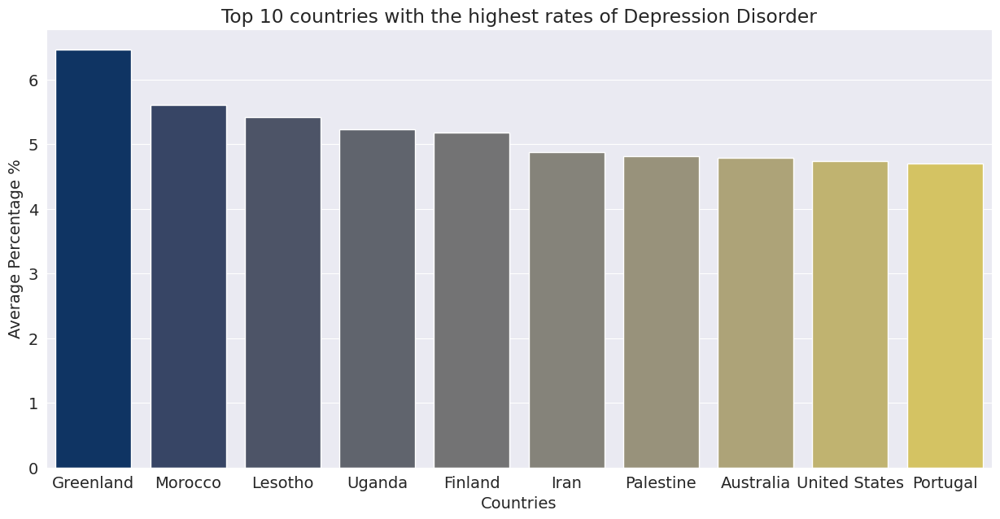

In [ ]:
plt.figure(figsize = (15,7))
sns.barplot(data = mean, 
            x = 'Entity', 
            y = 'Depression (%)', 
            order = mean.sort_values('Depression (%)', ascending = False).Entity.head(10),
            palette = 'cividis')

#Set title, legend and x y axis
plt.title('Top 10 countries with the highest rates of depression Disorder',
          fontweight='light')

plt.xlabel('Countries')
plt.ylabel('Average Percentage %')


The country with the highest depression percentage is Greenland.

### Which mental health disorders exhibit a higher prevalence rate among males compared to females? Among females, which mental health disorders have a higher prevalence rate compared to males?



In [ ]:
# filter the dataset for Canada 
canada_df = result_raw_df.loc[result_raw_df['Entity'] == 'Canada']
canada_df

,index,Entity,Code,Year,Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent),Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent),Population (historical estimates),Continent,Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent),Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent),Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)
8874,8874,Canada,CAN,1935,0.353767,0.284073,27541323.0,Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8875,8875,Canada,CAN,1936,0.353802,0.284094,27888813.0,Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8876,8876,Canada,CAN,1937,0.353838,0.284098,28224410.0,Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8877,8877,Canada,CAN,1938,0.353864,0.284110,28547964.0,Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8878,8878,Canada,CAN,1939,0.353882,0.284116,28860734.0,Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9128,9128,Canada,CAN,1987,NaN,NaN,26432894.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9129,9129,Canada,CAN,1988,NaN,NaN,26806125.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9130,9130,Canada,CAN,1989,NaN,NaN,27179497.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9131,9131,Canada,CAN,2020,NaN,NaN,37742157.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
fig = px.bar(canada_df, x = 'Year', y=['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)', 
                                       'Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)',
                                       'Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)',
                                       'Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)',
                                       'Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)'],
             barmode='group', title='Prevalence Rates of Mental Health Disorders for Females')

fig.update_layout(
    xaxis_title='Index',
    yaxis_title='Prevalence Rate',
    title='Prevalence Rates of Mental Health Disorders For Female',
    legend_title='Mental Health Disorders',
    height = 600,
    width=1200
)

fig.update_xaxes(type='category')  
fig.update_traces(width=0.8)  # Adjust the width of the bars
fig.update_layout(bargap=0.05)  # Adjust the spacing between the bars
fig.update_layout(uniformtext_minsize=8)  # Adjust the minimum text size for uniform text

fig.show()


## Insights 

The mental health disorders that females have a higher chance of having is Anxiety, then Depression.

In [ ]:
fig = px.bar(canada_df, x='Year', y=['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)', 
                                      'Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)', 
                                      'Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)',
                                      'Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)',
                                      'Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)'], 
             barmode='group', title='Prevalence Rates of Mental Health Disorders for Males')

fig.update_layout(
    xaxis_title='Index',
    yaxis_title='Prevalence Rate',
    title='Prevalence Rates of Mental Health Disorders for Males',
    legend_title='Mental Health Disorders',
    height = 600,
    width=1200
)

fig.update_xaxes(type='category')  
fig.update_traces(width=0.8)  # Adjust the width of the bars
fig.update_layout(bargap=0.05)  # Adjust the spacing between the bars
fig.update_layout(uniformtext_minsize=8)  # Adjust the minimum text size for uniform text

fig.show()


## Insights 

The graph shows that the mental health disorders that Males have a higher chance of having is Anxiety, then Depression, and then Bipolar Disorder.


### Are there any correlations or co-occurrence patterns between different mental health disorders based on the available data?


### Mental Health Disorders  

The choice of graph to display any coorrelations or patterns between different mental health disorders is a heatmap.

In [ ]:
mental_health_raw_df

,index,Entity,Code,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
0,0,Afghanistan,AFG,1990,0.16056,0.697779,0.101855,4.828830,1.677082,4.071831,0.672404
1,1,Afghanistan,AFG,1991,0.160312,0.697961,0.099313,4.829740,1.684746,4.079531,0.671768
2,2,Afghanistan,AFG,1992,0.160135,0.698107,0.096692,4.831108,1.694334,4.088358,0.670644
3,3,Afghanistan,AFG,1993,0.160037,0.698257,0.094336,4.830864,1.705320,4.096190,0.669738
4,4,Afghanistan,AFG,1994,0.160022,0.698469,0.092439,4.829423,1.716069,4.099582,0.669260
...,...,...,...,...,...,...,...,...,...,...,...
108548,108548,Zimbabwe,ZWE,2013,303564.60359,NaN,NaN,NaN,NaN,NaN,NaN
108549,108549,Zimbabwe,ZWE,2014,311665.769283,NaN,NaN,NaN,NaN,NaN,NaN
108550,108550,Zimbabwe,ZWE,2015,320638.507158,NaN,NaN,NaN,NaN,NaN,NaN
108551,108551,Zimbabwe,ZWE,2016,330437.353798,NaN,NaN,NaN,NaN,NaN,NaN


<ipython-input-114-e11bae215c00>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



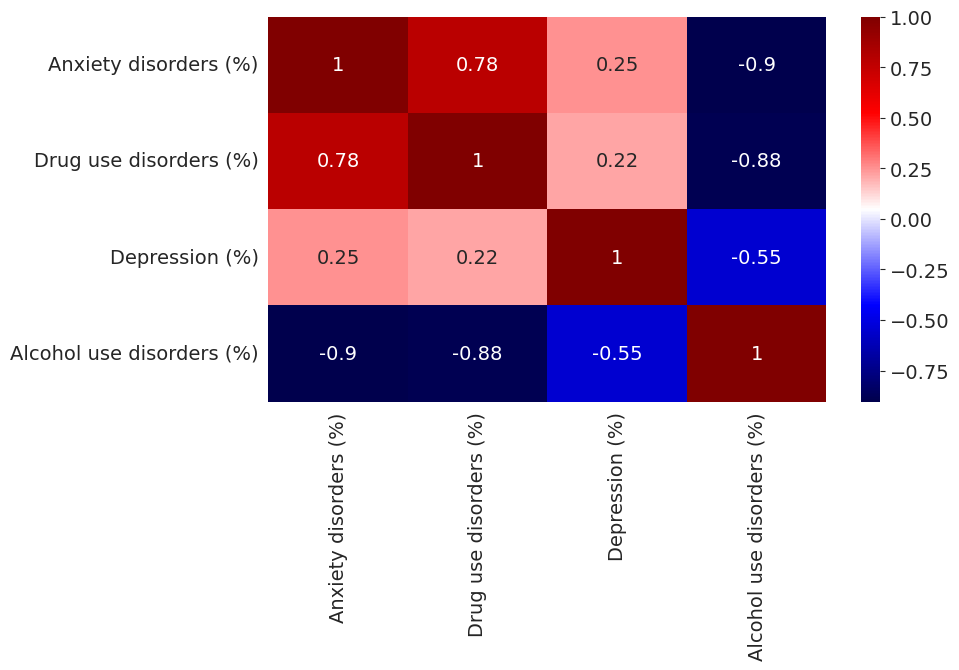

In [ ]:
discordd = mental_health_raw_df[mental_health_raw_df.columns[2:11]].corr()

discordd = sns.heatmap(discordd.corr(), cmap="seismic", annot=True)

As we can see from this graph, the strongest correlation between these mental health disorder is Drug Use Disorder and Anxiety disorder

In [ ]:
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


### Are there any trends of the mental health disorders over a period of time. i.e increasing, decreasing, or remained constant over time?

In [ ]:
canada_df_2 = mental_health_raw_df[mental_health_raw_df['Entity'] == 'Canada']

In [ ]:
canada_df_2

,index,Entity,Code,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
952,952,Canada,CAN,1990,0.313895,0.716075,0.442652,5.538491,1.802016,4.089515,1.529050
953,953,Canada,CAN,1991,0.314018,0.716383,0.442308,5.540824,1.811852,4.097314,1.518660
954,954,Canada,CAN,1992,0.314138,0.716693,0.441688,5.543399,1.830119,4.105661,1.510788
955,955,Canada,CAN,1993,0.314248,0.716988,0.442179,5.546001,1.854861,4.111715,1.505524
956,956,Canada,CAN,1994,0.314328,0.717223,0.442959,5.548263,1.882812,4.117476,1.502866
...,...,...,...,...,...,...,...,...,...,...,...
103060,103060,Canada,CAN,2013,1381335.47363,NaN,NaN,NaN,NaN,NaN,NaN
103061,103061,Canada,CAN,2014,1394733.32777,NaN,NaN,NaN,NaN,NaN,NaN
103062,103062,Canada,CAN,2015,1408679.85164,NaN,NaN,NaN,NaN,NaN,NaN
103063,103063,Canada,CAN,2016,1423298.88941,NaN,NaN,NaN,NaN,NaN,NaN


The choice of graph I have used is a line graph, I wanted to display all the mental health disorders seperately, so I have utilized the subplots() matplotlib function to display all the percentages of mental health disorders over a period of time.

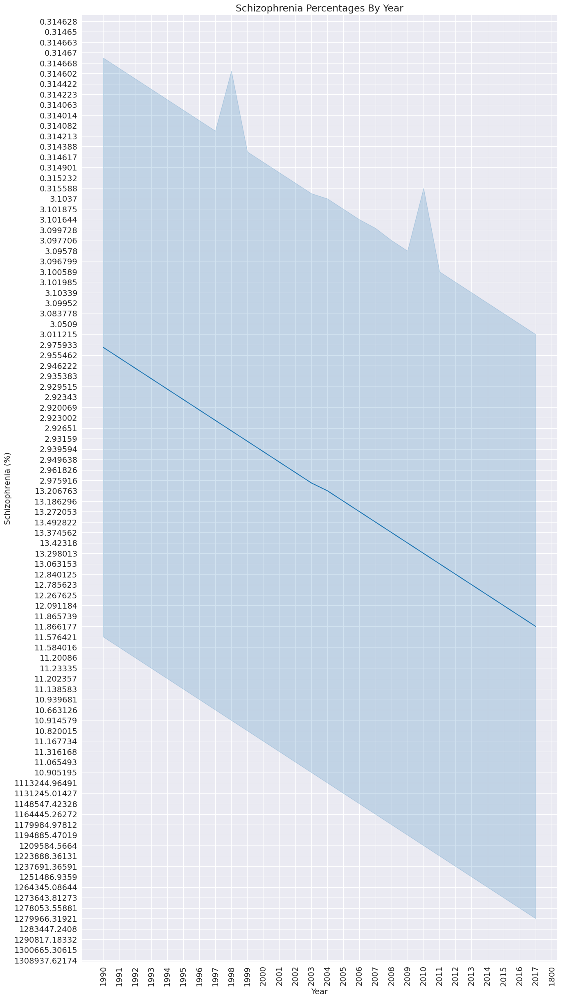

In [ ]:
plt.figure(figsize=(15, 30))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Schizophrenia (%)")
plt.title('Schizophrenia Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

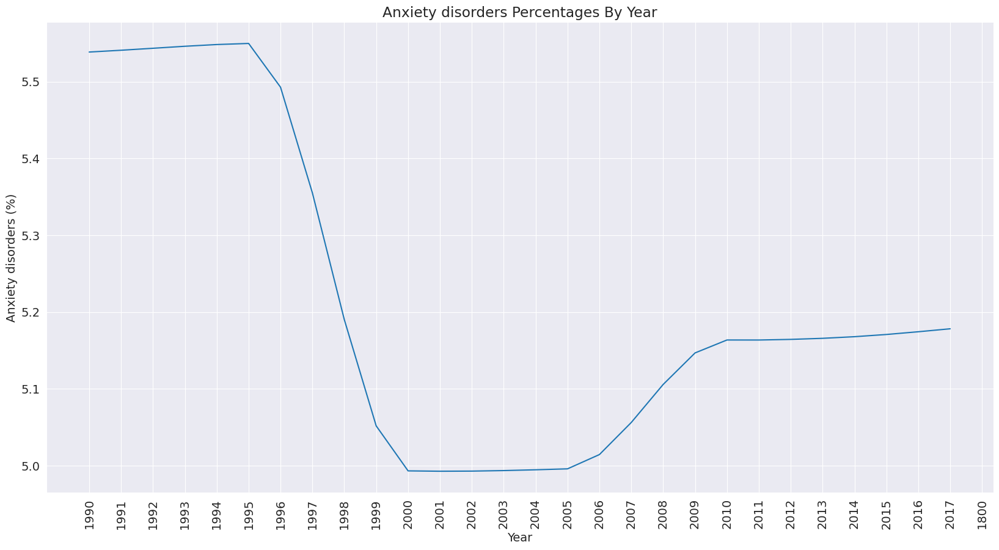

In [ ]:
plt.figure(figsize=(20, 10))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Anxiety disorders (%)")
plt.title('Anxiety disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

In [ ]:
canada_df_2

,index,Entity,Code,Year,Schizophrenia (%),Bipolar disorder (%),Eating disorders (%),Anxiety disorders (%),Drug use disorders (%),Depression (%),Alcohol use disorders (%)
952,952,Canada,CAN,1990,0.313895,0.716075,0.442652,5.538491,1.802016,4.089515,1.529050
953,953,Canada,CAN,1991,0.314018,0.716383,0.442308,5.540824,1.811852,4.097314,1.518660
954,954,Canada,CAN,1992,0.314138,0.716693,0.441688,5.543399,1.830119,4.105661,1.510788
955,955,Canada,CAN,1993,0.314248,0.716988,0.442179,5.546001,1.854861,4.111715,1.505524
956,956,Canada,CAN,1994,0.314328,0.717223,0.442959,5.548263,1.882812,4.117476,1.502866
...,...,...,...,...,...,...,...,...,...,...,...
103060,103060,Canada,CAN,2013,1381335.47363,NaN,NaN,NaN,NaN,NaN,NaN
103061,103061,Canada,CAN,2014,1394733.32777,NaN,NaN,NaN,NaN,NaN,NaN
103062,103062,Canada,CAN,2015,1408679.85164,NaN,NaN,NaN,NaN,NaN,NaN
103063,103063,Canada,CAN,2016,1423298.88941,NaN,NaN,NaN,NaN,NaN,NaN


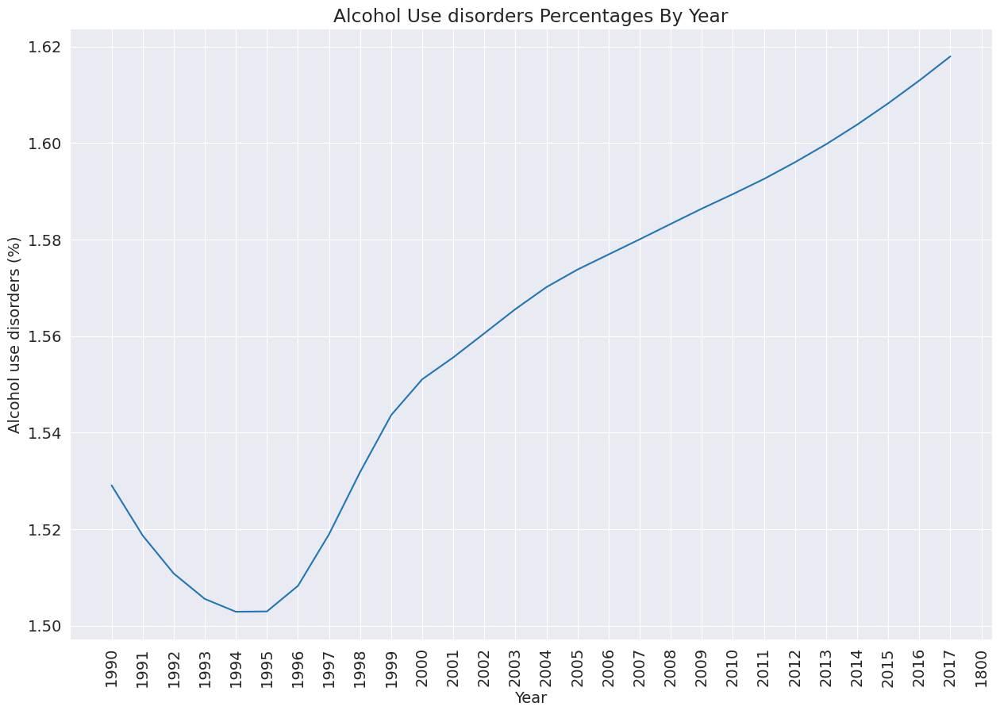

In [ ]:
plt.figure(figsize=(15, 10))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Alcohol use disorders (%)")
plt.title('Alcohol Use disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

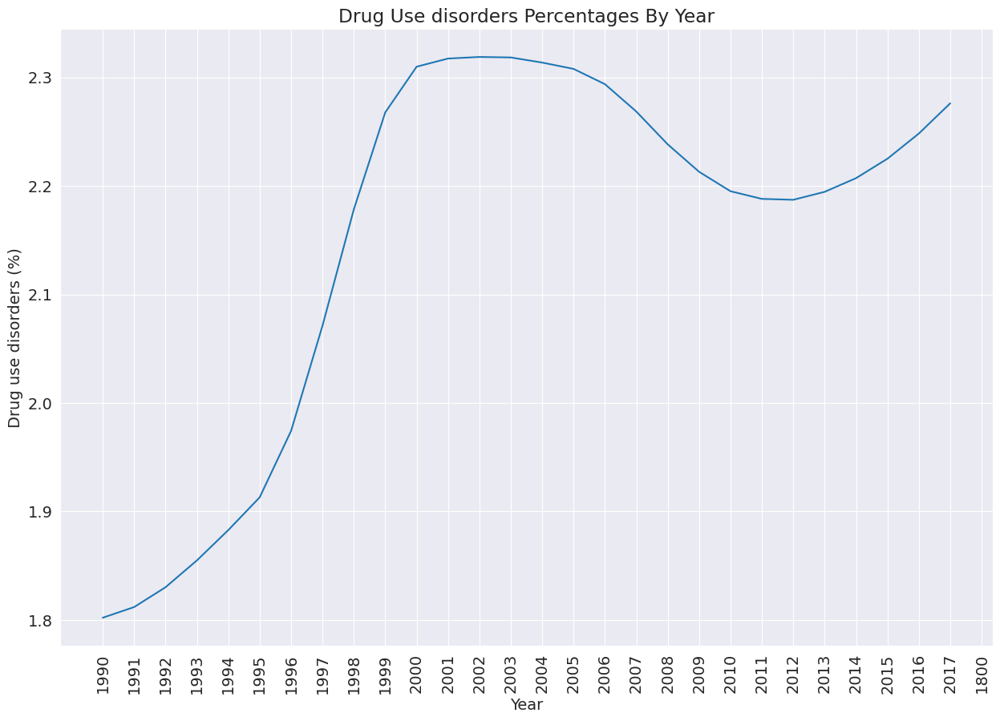

In [ ]:
plt.figure(figsize=(15, 10))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Drug use disorders (%)")
plt.title('Drug Use disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

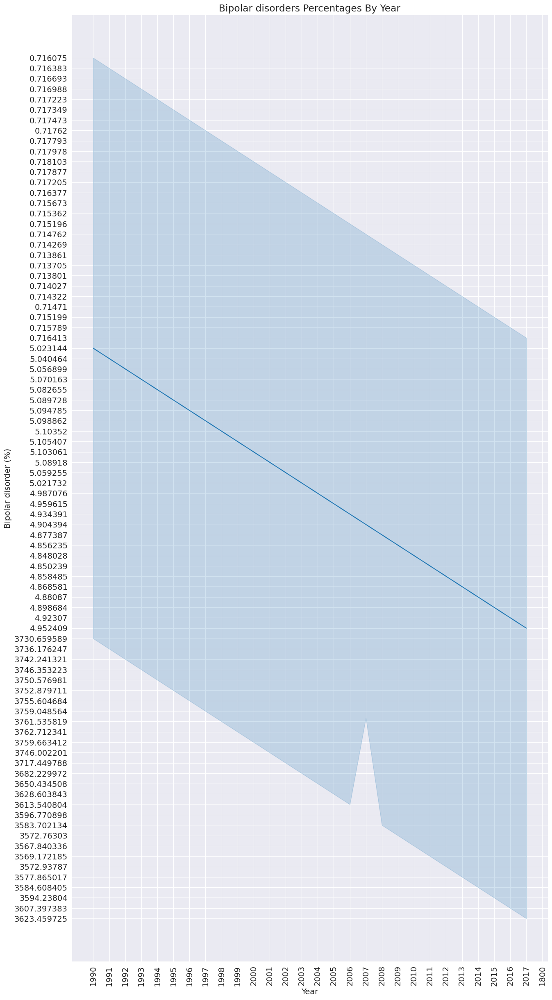

In [ ]:
plt.figure(figsize=(15, 30))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Bipolar disorder (%)")
plt.title('Bipolar disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

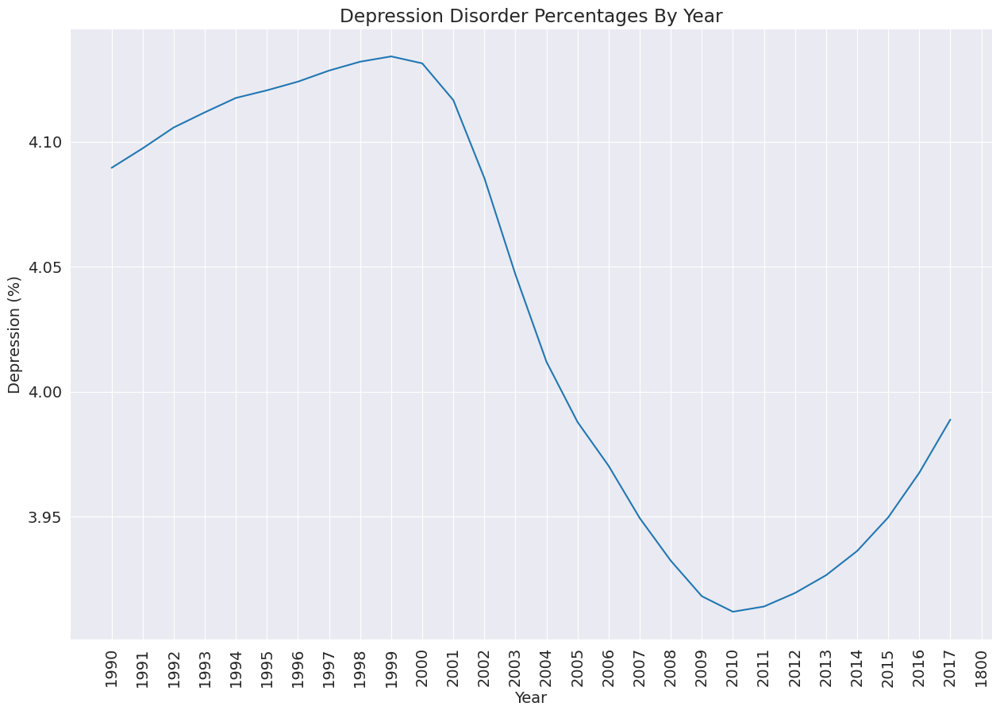

In [ ]:
plt.figure(figsize=(15, 10))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Depression (%)")

plt.title('Depression Disorder Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees
plt.show()

From these graphs, we see that bipolar disorder and schizophrenia has remained constant over the years. Depression and anxiety disorders have decreased over the years but it the graph is curving upwards in the recent years which means there might be a spike again upwards. However, drug use disorder and alcohol use disorder has increased over the years. 

In [ ]:
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


# Conclusion

If you have made it down here, I want to thank you reading this! This is my first project in the world of data science, and through this, I have become so passionate about it and will keep exploring different data sets and libraries. 

Here are the questions I aim to answer in this dataset:

1. What are the top 10 countries with the highest percentage of Depressive Disorder?

2. Which mental health disorders exhibit a higher prevalence rate among males compared to females? Among females, which mental health disorders have a higher prevalence rate compared to males?

3. Are there any correlations or co-occurrence patterns between different mental health disorders based on the available data?

4. Are there any trends of the mental health disorders over a period of time. i.e increasing, decreasing, or remained constant over time?


Here are the results to these questions:

1. The country with the highest percentage of Depressive Disorder is Greenland

2. The mental health disorders that females exhibit a higher prevalance is anxiety and depression. For men, it is anxiety, depression, and bipolar disorder.

3. The strongest correlation between the mental health disorders is anxiety use disorder and drug use disorder

4. Bipolar disorder and schizophrenia has remained constant over the years. Depression and anxiety disorders have decreased over the years but it the graph is curving upwards. Drug use disorder and alcohol use disorder have increased over the years. 

Feel free to reach out if you have any questions or just want to say Hi!

LinkedIn: https://www.linkedin.com/in/manalafzal/

Email: manal.afzal479@gmail.com


In [ ]:
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


# References 

Here are all the documentation that has helped me complete this datascience. Feel free to check it out. 

References:

https://www.nimh.nih.gov/

https://pandas.pydata.org/

https://matplotlib.org/

https://seaborn.pydata.org/

https://plotly.com/python/line-charts/


In [ ]:
import jovian

In [ ]:
jovian.commit()